# Vascular morphogenesis simulation using the DMB

Author: Iker Lomas Javaloyes

Date: December 2025

Email: ikerlomas@ifisc.uib-csic.es

Description: Main configuration file for the DMB/Eden model simulation.

Import necessary libraries

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.colors import ListedColormap, BoundaryNorm
from IPython.display import display, Image
import cupy as cp
import time

In [28]:
np.random.seed(42)  # For reproducibility

## Parameters Configuration

In [ ]:
# ==========================================
# PHYSICAL CONFIGURATION
# ==========================================
GRID_SIZE = 512  # Highest resolution possible with CUDA
MAX_ITERATIONS = 500000
FRAMES_TO_SAVE = 250

# Laplace Parameters
RELAXATION_STEPS = 150  # Increased for higher precision
RELAXATION_TOL = 1e-5
ETA = 1.0  # η=1 as in original DBM

# Tissue Types
TISSUE = 0
ARTERY = 1
VEIN = 2
OBSTACLE = -1

BACKEND = 'CUDA'

## Main Functions

In [46]:
# ==========================================
# CUDA-OPTIMIZED FUNCTIONS
# ==========================================

def solve_laplace_neumann_gpu(pressure, grid, iterations=RELAXATION_STEPS, tol=RELAXATION_TOL):
    """
    Solves ∇²P = 0 on GPU with NEUMANN boundary conditions.
    Optimized with vectorized operations.
    """
    
    P = pressure.copy()
    is_vessel = (grid != TISSUE)
    
    for iteration in range(iterations):
        P_old = P.copy()
        
        # Discretized Laplacian (5-point stencil) - Vectorized on GPU
        P[1:-1, 1:-1] = 0.25 * (P[0:-2, 1:-1] + P[2:, 1:-1] + 
                                 P[1:-1, 0:-2] + P[1:-1, 2:])
        
        # NEUMANN conditions at boundaries (reflection)
        P[0, :] = P[1, :]
        P[-1, :] = P[-2, :]
        P[:, 0] = P[:, 1]
        P[:, -1] = P[:, -2]
        
        # Maintain Dirichlet at vessels
        P[is_vessel] = pressure[is_vessel]
        
        # Convergence criterion
        error = cp.max(cp.abs(P - P_old))
        if error < tol and iteration > 10:
            break
    
    return P


def compute_growth_probabilities_gpu(pressure, grid):
    """
    Calculates growth probabilities on GPU.
    Optimized version using roll and vectorized operations.
    """
    
    grads = cp.zeros_like(pressure, dtype=cp.float32)
    
    # Calculate gradient magnitude on GPU
    for dx, dy in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
        P_shift = cp.roll(pressure, shift=(dx, dy), axis=(0, 1))
        grad_component = cp.abs(pressure - P_shift)
        grads += grad_component
    
    grads = cp.sqrt(grads)
    probs = grads ** ETA
    
    return grads, probs


def growth_step_gpu(grid, pressure):
    """
    Growth step on GPU with vectorized candidate search.
    """
    
    tissue_mask = (grid == TISSUE)
    vessel_mask = (grid != TISSUE)
    
    # Convolution with kernel to find neighbors (GPU)
    kernel = cp.array([[0, 1, 0], [1, 0, 1], [0, 1, 0]], dtype=cp.float32)
    from cupyx.scipy import ndimage
    has_vessel_neighbor = ndimage.convolve(vessel_mask.astype(cp.float32), kernel, mode='constant') > 0
    
    candidates = tissue_mask & has_vessel_neighbor
    
    if not cp.any(candidates):
        return False, 0.0, 0
    
    # Calculate probabilities
    grads, probs = compute_growth_probabilities_gpu(pressure, grid)
    
    # Select winner
    candidate_indices = cp.where(candidates)
    candidate_probs = probs[candidate_indices]
    
    if cp.sum(candidate_probs) == 0:
        return False, 0.0, 0
    
    candidate_probs = candidate_probs / cp.sum(candidate_probs)
    
    # Monte Carlo selection on GPU
    flat_indices = cp.ravel_multi_index(candidate_indices, grid.shape)
    probabilities_array = cp.asnumpy(candidate_probs)
    winner_idx_in_candidates = np.random.choice(probabilities_array.size, p=probabilities_array)
    
    winner_flat_index = flat_indices[winner_idx_in_candidates]
    winner_pos = cp.unravel_index(winner_flat_index, grid.shape)
    x, y = int(winner_pos[0]), int(winner_pos[1])
    
    # Determine vessel type
    max_pressure_neighbor = -1
    new_vessel_type = ARTERY
    
    for dx, dy in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
        nx, ny = (x + dx) % grid.shape[0], (y + dy) % grid.shape[1]
        if grid[nx, ny] != TISSUE:
            if float(pressure[nx, ny]) > max_pressure_neighbor:
                max_pressure_neighbor = float(pressure[nx, ny])
                new_vessel_type = int(grid[nx, ny])
    
    # Expand vessel
    grid[x, y] = new_vessel_type
    pressure[x, y] = 1.0 if new_vessel_type == ARTERY else 0.0
    
    max_grad = float(grads[x, y])
    
    return True, max_grad, new_vessel_type

## Simulations

### GPU

With CuPy solver and the same boundary conditions that used in the paper.

#### Six diffenrets nucleation points


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 132500/500000 | Vessels: 132506 | Speed: 56 iter/s | Time: 2381.9s
✓ Simulation completed (saturation) at iteration 132863

✓ Simulation completed: 132863 iterations in 2383.78s
  Average speed: 56 iter/s
  Total vessels: 132869
  Vascular fraction: 50.69%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_6_points_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_6_points_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_6_points_cuda.gif


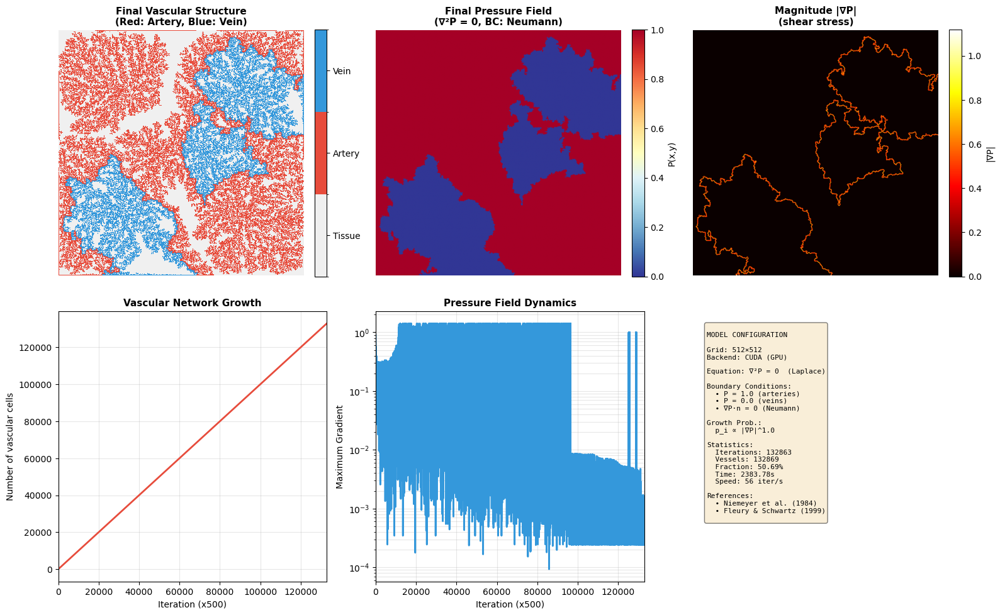

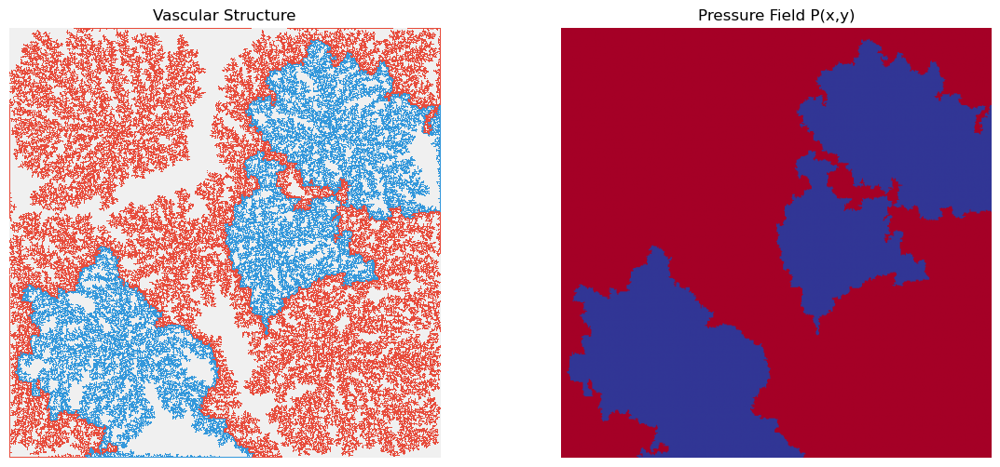


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_6_points_cuda.gif


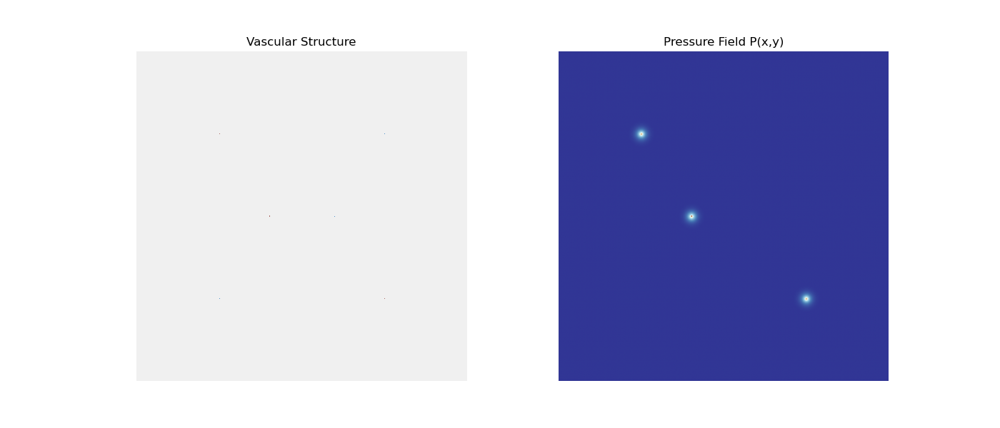

In [31]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    points = [
        (size // 4, size // 4, ARTERY),
        (3 * size // 4, size // 4, VEIN),
        (size // 4, 3 * size // 4, VEIN),
        (3 * size // 4, 3 * size // 4, ARTERY),
        (size // 2, size // 2 - 50, ARTERY),
        (size // 2, size // 2 + 50, VEIN),
    ]
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_6_points_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")

# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

#### Random nucleation points


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 132000/500000 | Vessels: 132010 | Speed: 53 iter/s | Time: 2480.8s
✓ Simulation completed (saturation) at iteration 132102

✓ Simulation completed: 132102 iterations in 2481.32s
  Average speed: 53 iter/s
  Total vessels: 132112
  Vascular fraction: 50.40%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_random_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_random_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_random_cuda.gif


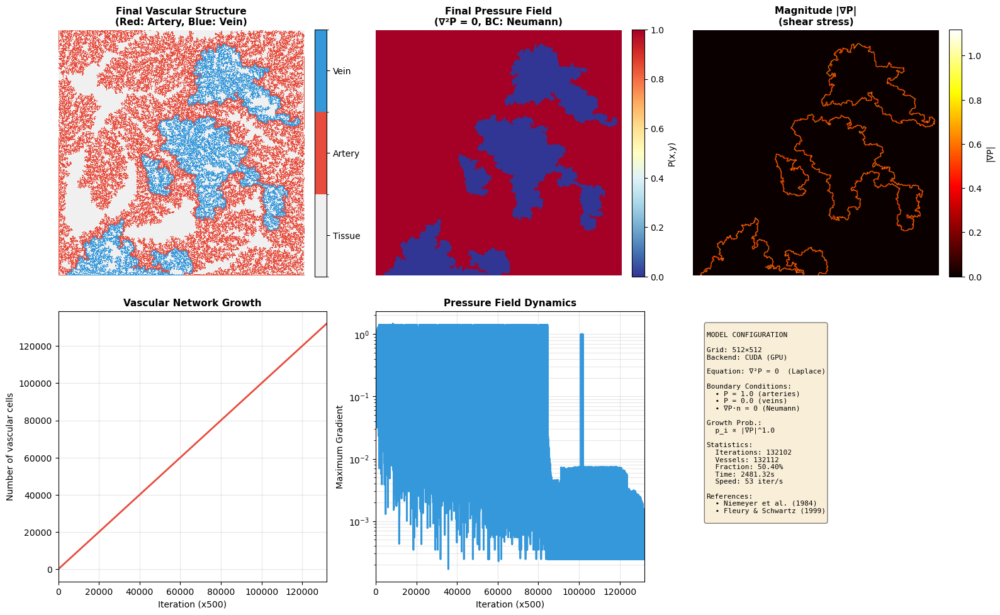

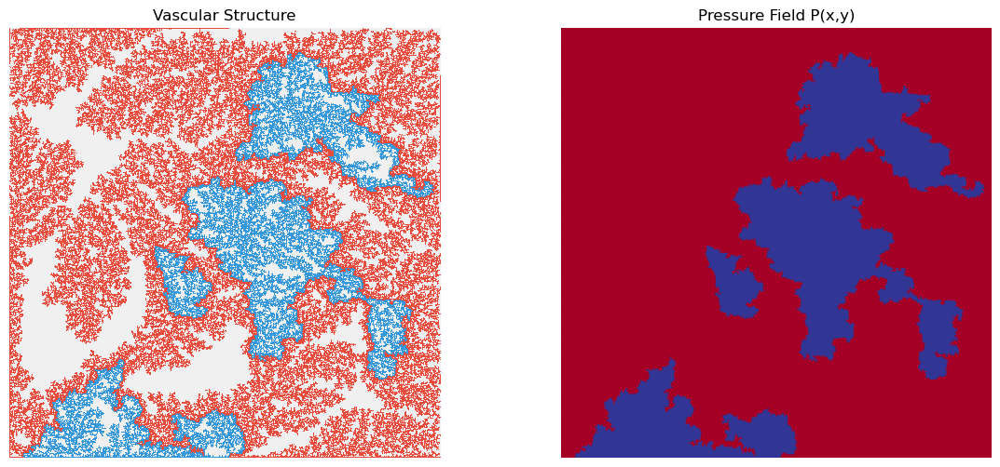


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_random_cuda.gif


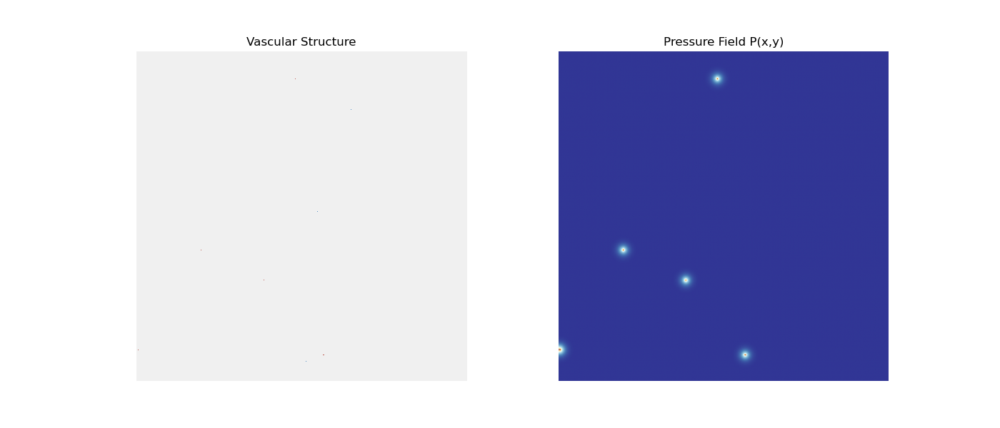

In [32]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    num_arteries = 5
    num_veins = 5
    points = []

    # Arterias aleatorias
    for _ in range(num_arteries):
        x = np.random.randint(0, size)
        y = np.random.randint(0, size)
        points.append((x, y, ARTERY))

    # Venas aleatorias
    for _ in range(num_veins):
        x = np.random.randint(0, size)
        y = np.random.randint(0, size)
        points.append((x, y, VEIN))
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_random_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")


# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

#### Random nucleation points - for different ETA

**ETA = 0.5**


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 172500/500000 | Vessels: 172510 | Speed: 39 iter/s | Time: 4407.2s
✓ Simulation completed (saturation) at iteration 172807

✓ Simulation completed: 172807 iterations in 4413.37s
  Average speed: 39 iter/s
  Total vessels: 172817
  Vascular fraction: 65.92%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_random_ETA0.5_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_random_ETA0.5_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_random_ETA0.5_cuda.gif


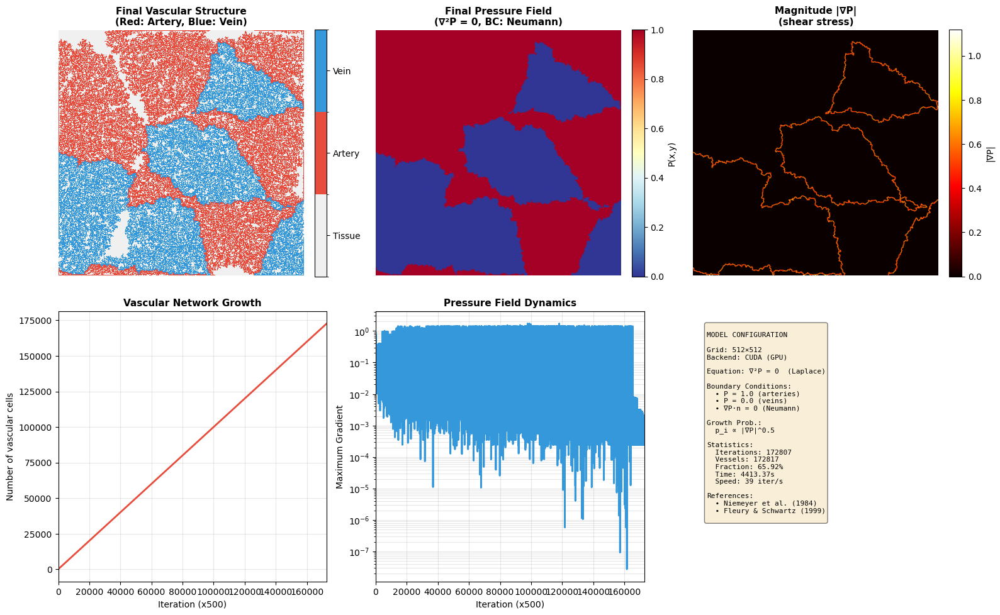

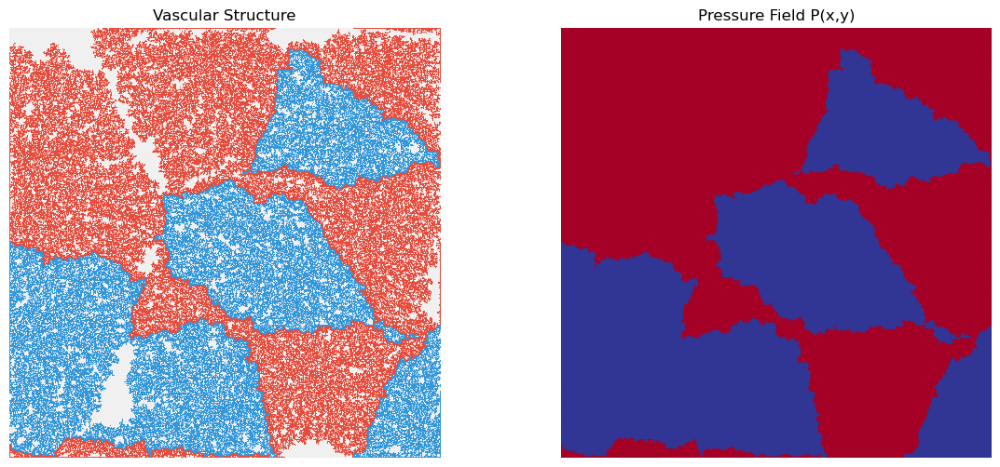


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_random_ETA0.5_cuda.gif


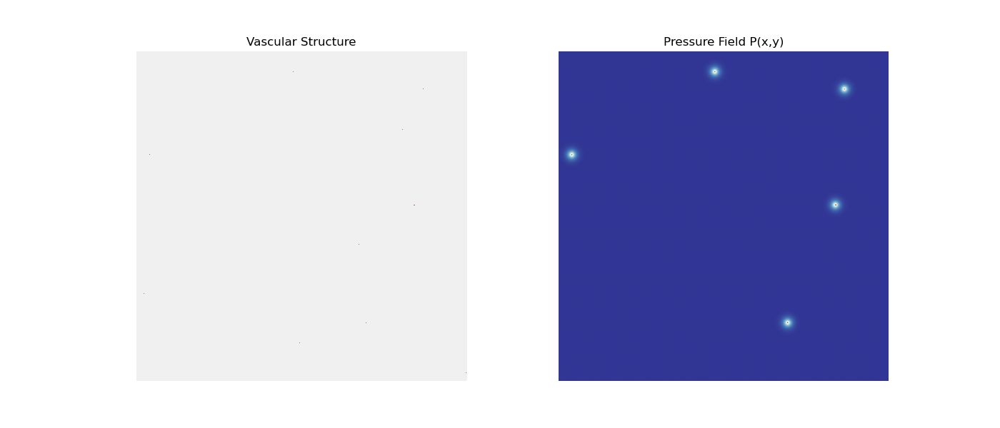

In [47]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""
ETA = 0.5  # η=0.5 for different growth dynamics

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    num_arteries = 5
    num_veins = 5
    points = []

    # Arterias aleatorias
    for _ in range(num_arteries):
        x = np.random.randint(0, size)
        y = np.random.randint(0, size)
        points.append((x, y, ARTERY))

    # Venas aleatorias
    for _ in range(num_veins):
        x = np.random.randint(0, size)
        y = np.random.randint(0, size)
        points.append((x, y, VEIN))
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = f'data/vascular_morphogenesis_random_ETA{ETA}_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")


# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

**ETA = 1.5**


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 112000/500000 | Vessels: 112010 | Speed: 17 iter/s | Time: 6510.3s
✓ Simulation completed (saturation) at iteration 112266

✓ Simulation completed: 112266 iterations in 6515.61s
  Average speed: 17 iter/s
  Total vessels: 112276
  Vascular fraction: 42.83%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_random_ETA1.5_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_random_ETA1.5_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_random_ETA1.5_cuda.gif


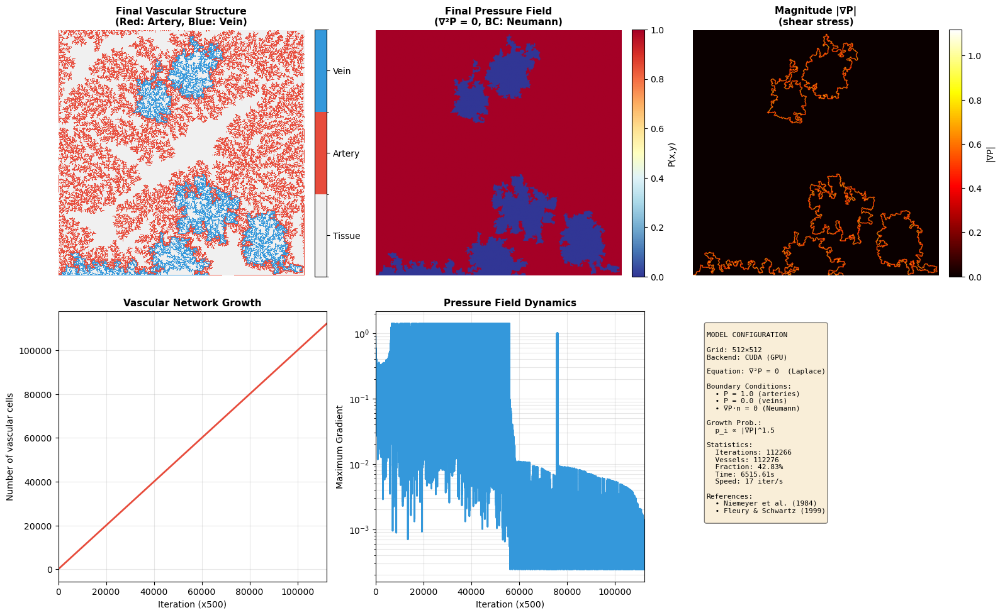

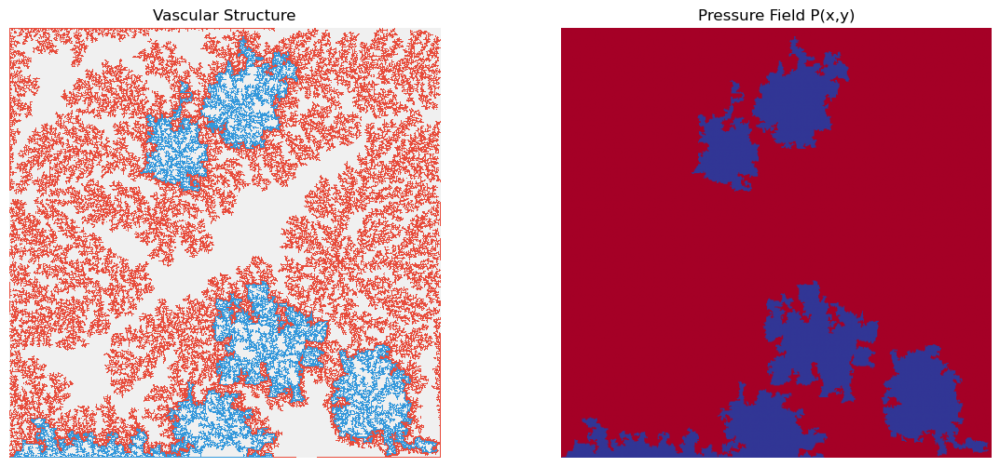


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_random_ETA1.5_cuda.gif


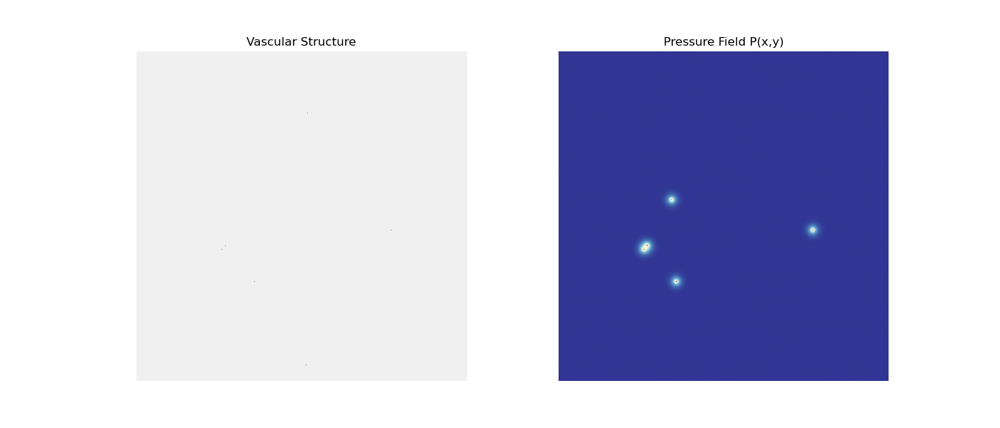

In [48]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""
ETA = 1.5  # η=0.5 for different growth dynamics

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    num_arteries = 5
    num_veins = 5
    points = []

    # Arterias aleatorias
    for _ in range(num_arteries):
        x = np.random.randint(0, size)
        y = np.random.randint(0, size)
        points.append((x, y, ARTERY))

    # Venas aleatorias
    for _ in range(num_veins):
        x = np.random.randint(0, size)
        y = np.random.randint(0, size)
        points.append((x, y, VEIN))
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = f'data/vascular_morphogenesis_random_ETA{ETA}_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")


# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

#### Columns of nucleation points


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 136500/500000 | Vessels: 136526 | Speed: 80 iter/s | Time: 1704.7s
✓ Simulation completed (saturation) at iteration 136865

✓ Simulation completed: 136865 iterations in 1706.51s
  Average speed: 80 iter/s
  Total vessels: 136891
  Vascular fraction: 52.22%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_columns_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_columns_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_columns_cuda.gif


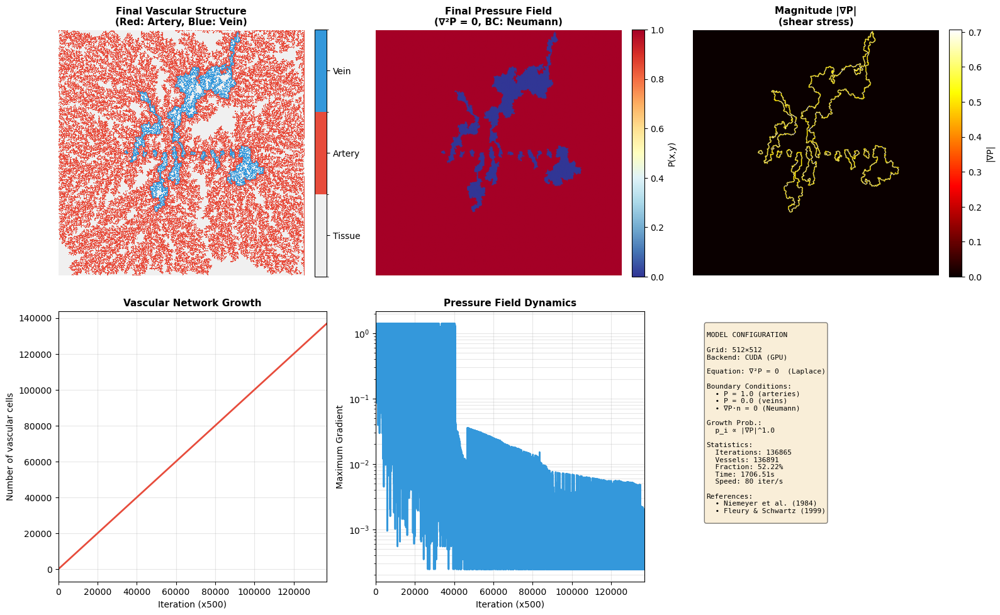

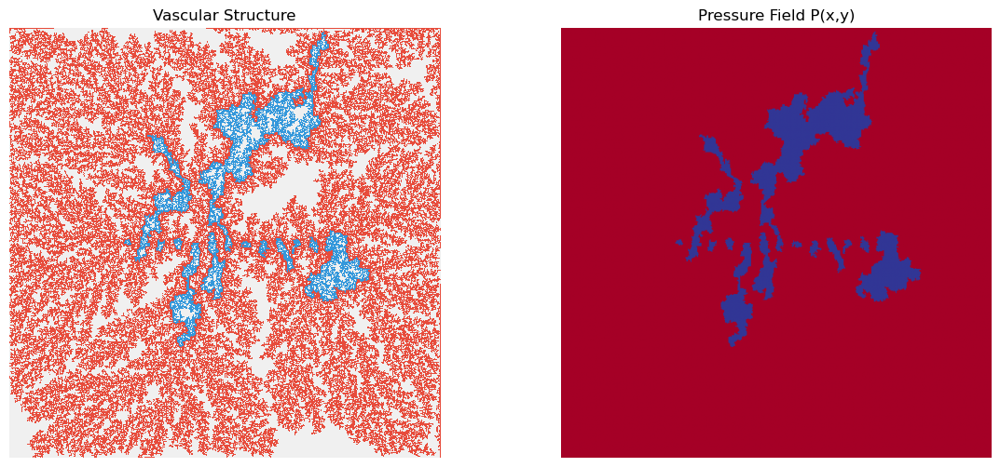


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_columns_cuda.gif


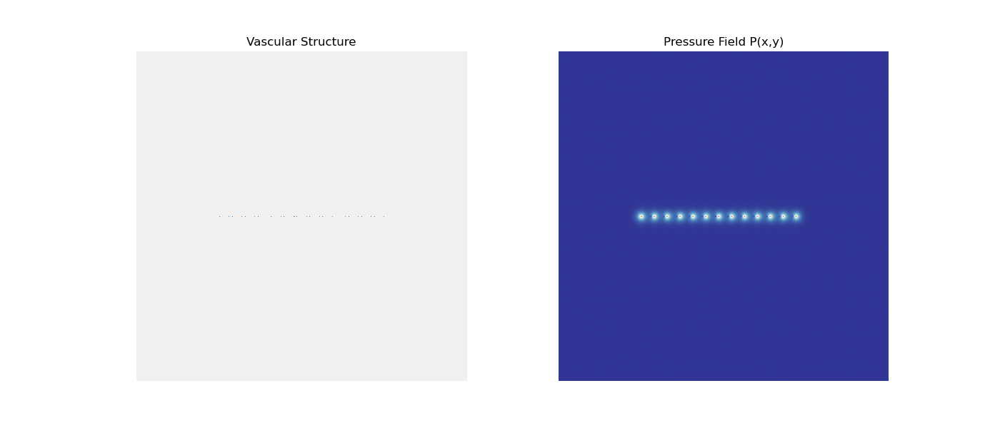

In [ ]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""

ETA = 1

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    points = []
    for y in range(size // 4, 3 * size // 4, 20):
        points.append((size // 2, y, ARTERY))        # columna central de arterias
        points.append((size // 2, size - y - 1, VEIN))  # simétricas como venas
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_columns_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")


# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

#### Center nucleation point


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 133000/500000 | Vessels: 133001 | Speed: 177 iter/s | Time: 749.8s
✓ Simulation completed (saturation) at iteration 133209

✓ Simulation completed: 133209 iterations in 750.90s
  Average speed: 177 iter/s
  Total vessels: 133210
  Vascular fraction: 50.82%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_center_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_center_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_center_cuda.gif


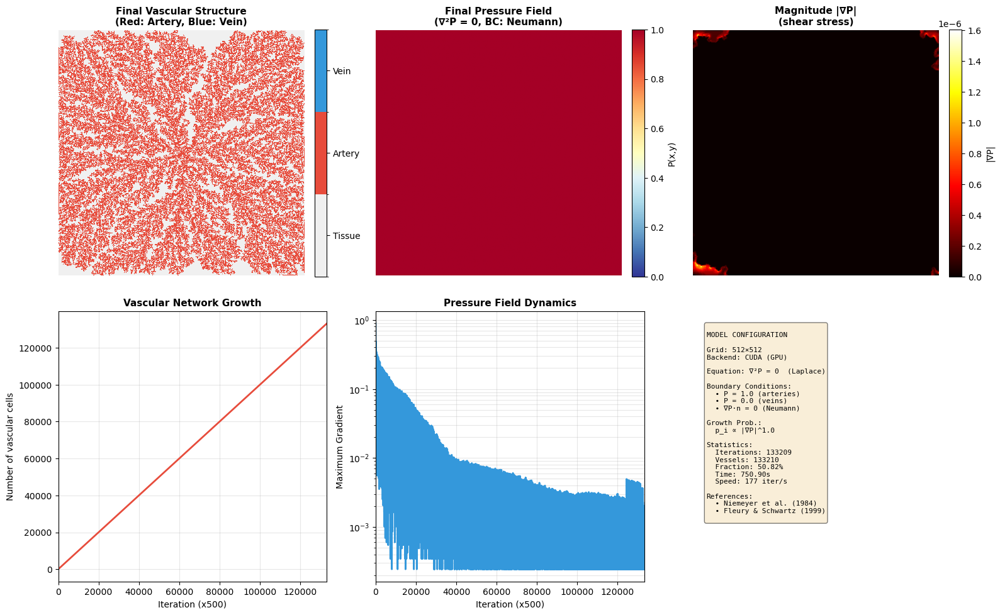

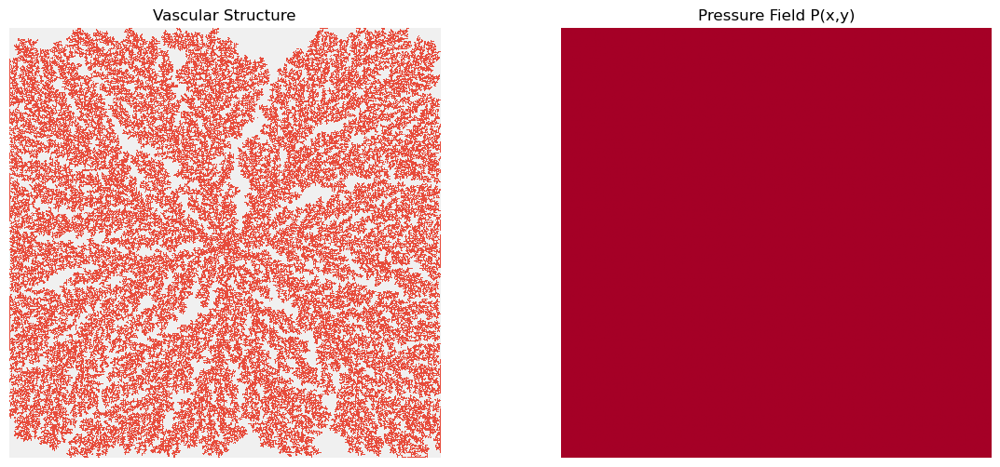


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_center_cuda.gif


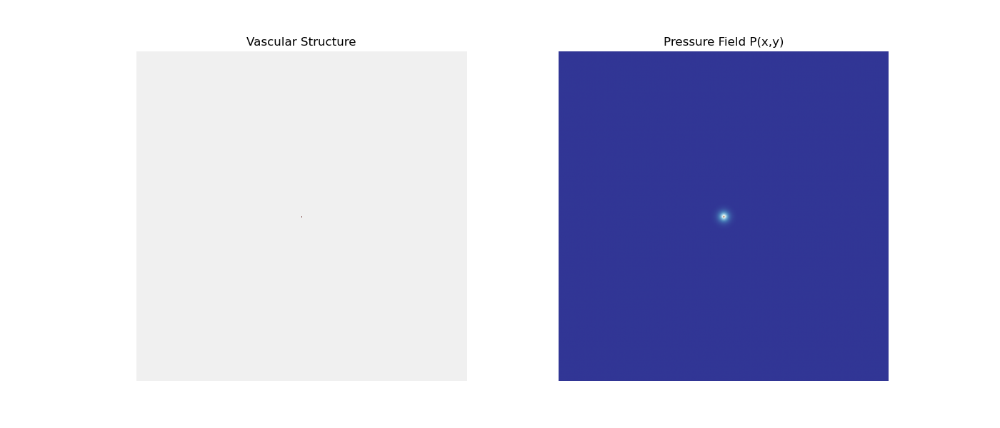

In [34]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    # Opción A: una ARTERIA en el centro
    points = [
        (size // 2, size // 2, ARTERY),  # centro
    ]
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_center_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")


# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)


try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

#### Up and down nucleation points


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 138500/500000 | Vessels: 138502 | Speed: 75 iter/s | Time: 1850.5s
✓ Simulation completed (saturation) at iteration 138825

✓ Simulation completed: 138825 iterations in 1852.19s
  Average speed: 75 iter/s
  Total vessels: 138827
  Vascular fraction: 52.96%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_arriba_abajo_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_arriba_abajo_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_arriba_abajo_cuda.gif


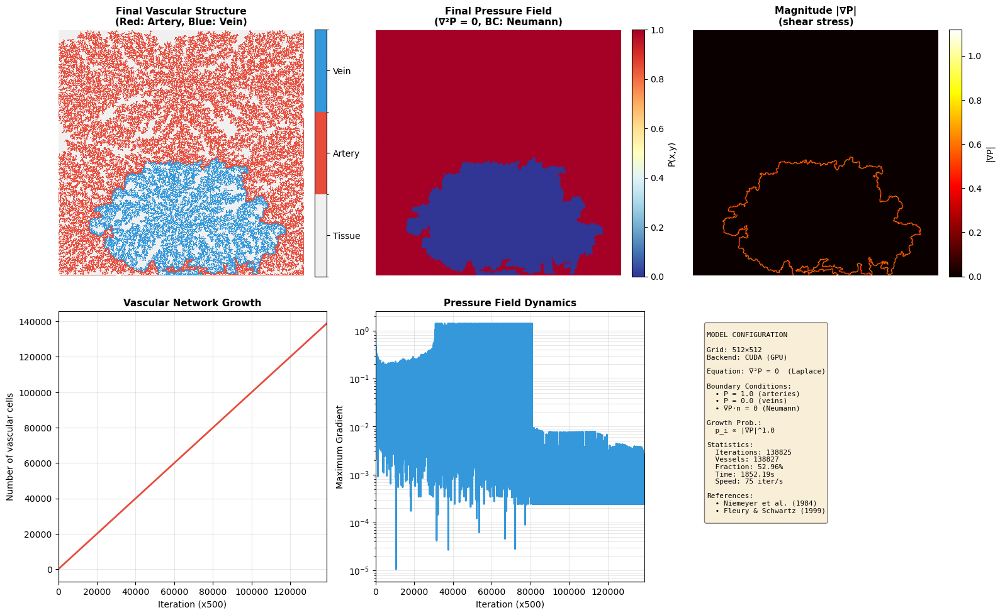

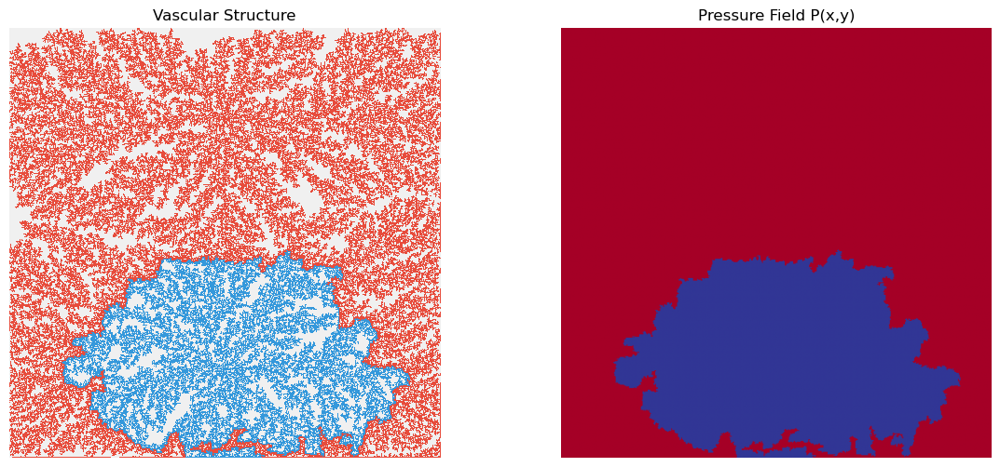


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_arriba_abajo_cuda.gif


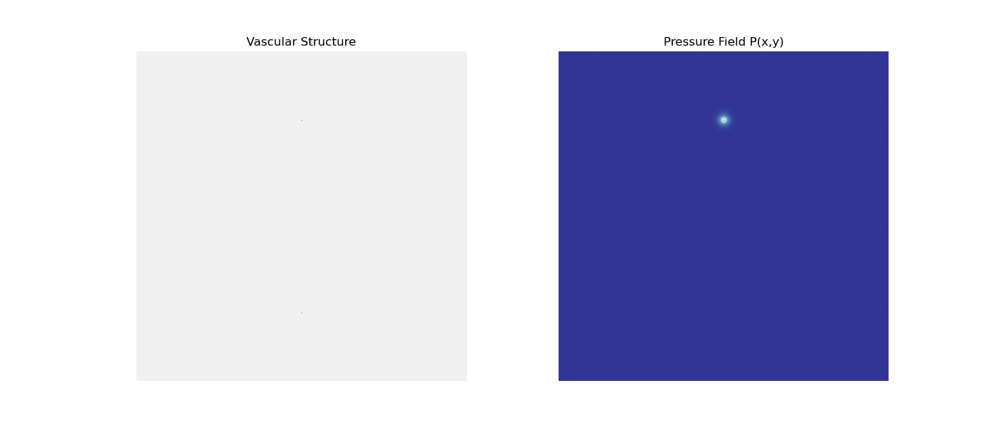

In [41]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)

CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5

BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)

"""

def initialize_grid_gpu(size):
    """Initializes grid on GPU"""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    # Opción A: una ARTERIA en el centro
    points = [
        (size // 2 - 150, size // 2, ARTERY),  # arteria, un píxel encima del centro
        (size // 2 + 150, size // 2, VEIN),    # vena, un píxel debajo del centro
    ]
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure

# ==========================================

print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED)                 ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================

print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")

history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []

start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                      f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s", end='\r')
        
        # Solve Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Growth
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Save frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transfer results to CPU for visualization
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================

print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Vascular Structure
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular, interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)', fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Pressure Field
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1, interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)', fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradients
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Vessel Evolution
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Gradient Evolution
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Information
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')

info_text = f"""
MODEL CONFIGURATION

Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}

Equation: ∇²P = 0  (Laplace)

Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)

Growth Prob.:
  p_i ∝ |∇P|^{ETA}

Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s

References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""

ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_arriba_abajo_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")


# ==========================================
# ANIMATION
# ==========================================

print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(history_grid[0], cmap=cmap_vascular, norm=norm_vascular, 
                          interpolation='nearest')
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(history_pressure[0], cmap='RdYlBu_r', vmin=0, vmax=1,
                                  interpolation='bilinear')
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(fig_anim, update_animation, frames=len(history_grid),
                               interval=50, blit=True, repeat=True)

animation_name = 'data/vascular_morphogenesis_arriba_abajo_cuda'

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")
    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ MP4 failed: {e}")
except Exception as e2:
        print(f"⚠ GIF failed: {e2}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)

print(f"I saved the animation as {animation_name}.gif")
display(Image(filename=f'{animation_name}.gif'))

#### New model - With threshold for local pressure

In [38]:
def growth_step_gpu(grid, pressure):
    """
    Un paso de crecimiento (DBM) en GPU.
    - Candidatos: tejido vecino a vasos.
    - Selección: prob. ∝ 'grads' = función de variación local de P.
    - Tipo de vaso:
        * P alta -> más probable ARTERY
        * P baja -> más probable VEIN (reservorio)
    """

    tissue_mask = (grid == TISSUE)
    vessel_mask = (grid != TISSUE)

    # Candidatos: tejido con al menos un vecino vascular (4-conectividad)
    kernel = cp.array([[0, 1, 0],
                       [1, 0, 1],
                       [0, 1, 0]], dtype=cp.float32)
    from cupyx.scipy import ndimage
    has_vessel_neighbor = ndimage.convolve(
        vessel_mask.astype(cp.float32),
        kernel,
        mode='constant'
    ) > 0

    candidates = tissue_mask & has_vessel_neighbor

    if not cp.any(candidates):
        return False, 0.0, 0

    # Campo de “gradientes” (variación local de P) y probabilidades
    grads, probs = compute_growth_probabilities_gpu(pressure, grid)

    candidate_indices = cp.where(candidates)
    candidate_probs = probs[candidate_indices]

    if cp.sum(candidate_probs) == 0:
        return False, 0.0, 0

    candidate_probs = candidate_probs / cp.sum(candidate_probs)

    # Elección Monte Carlo
    flat_indices = cp.ravel_multi_index(candidate_indices, grid.shape)
    probabilities_array = cp.asnumpy(candidate_probs)
    winner_idx_in_candidates = np.random.choice(
        probabilities_array.size,
        p=probabilities_array
    )

    winner_flat_index = flat_indices[winner_idx_in_candidates]
    winner_pos = cp.unravel_index(winner_flat_index, grid.shape)
    x, y = int(winner_pos[0]), int(winner_pos[1])

    # -----------------------------------------
    # REGLA DE TIPO DE VASO CON SESGO VENOSO
    # -----------------------------------------
    p_local = float(pressure[x, y])

    # Umbral bajo para favorecer venas (reservorio):
    #   - cerca de fuentes (P≈1) -> arterias
    #   - gran parte del tejido (P medio/bajo) -> venas
    P_THRESHOLD = 0.4

    if p_local >= P_THRESHOLD:
        new_vessel_type = ARTERY
    else:
        new_vessel_type = VEIN

    # Fijar tipo y presión
    grid[x, y] = new_vessel_type
    pressure[x, y] = 1.0 if new_vessel_type == ARTERY else 0.0

    max_grad = float(grads[x, y])

    return True, max_grad, new_vessel_type


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED, MORE REALISTIC) ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 100500/500000 | Vessels: 100504 | Speed: 69 iter/s | Time: 1466.6s
✓ Simulation completed (saturation) at iteration 100824

✓ Simulation completed: 100824 iterations in 1468.33s
  Average speed: 69 iter/s
  Total vessels: 100828
  Vascular fraction: 38.46%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_more_realistic_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_more_realistic_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_more_realistic_cuda.gif


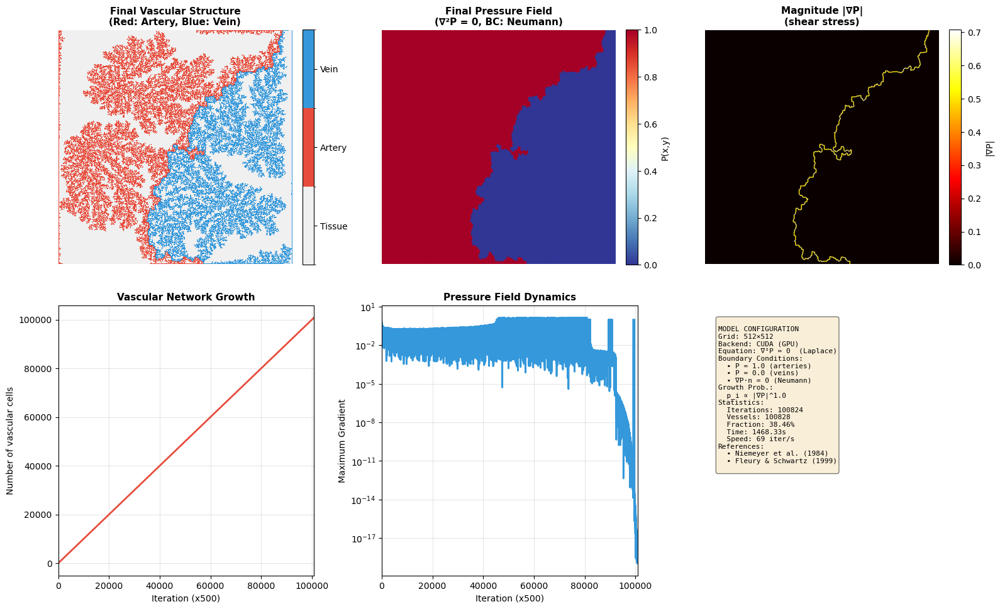

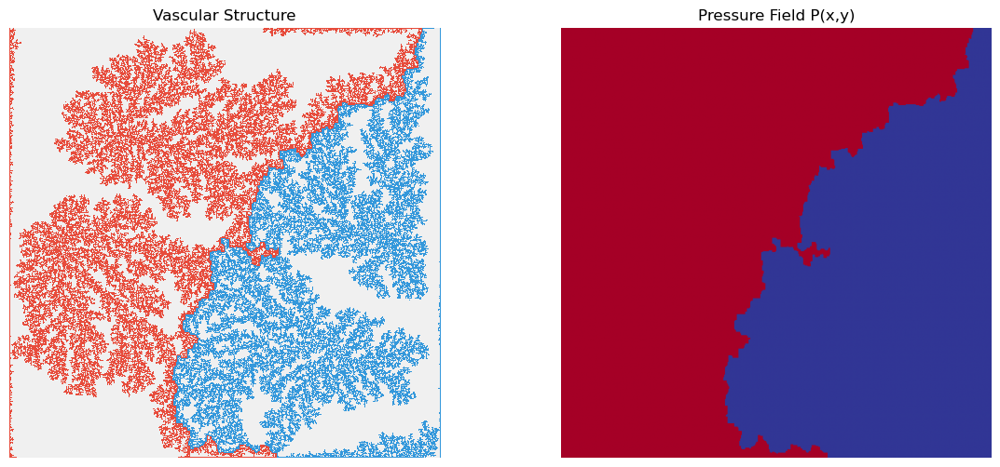


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_more_realistic_cuda.gif


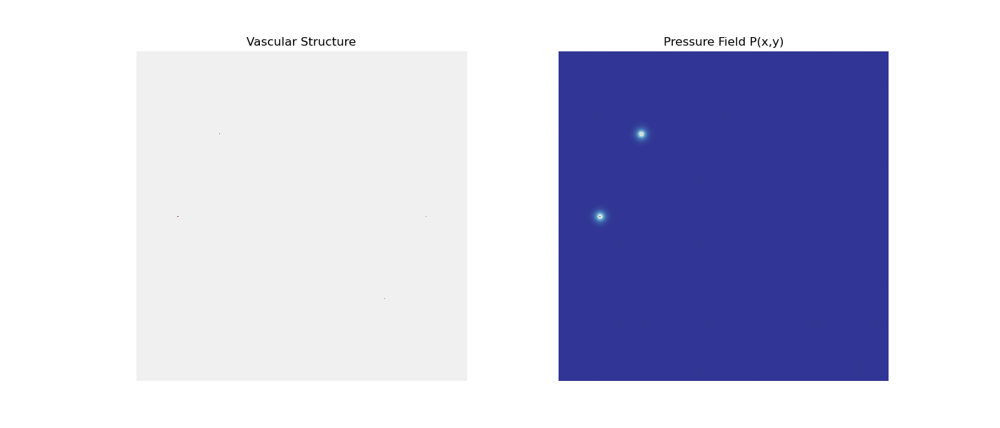

In [39]:
"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Based on: Fleury & Schwartz (1999) and Niemeyer et al. (1984)
CUDA VERSION: GPU accelerated implementation using CuPy
For maximum performance: requires NVIDIA GPU with compute capability >= 3.5
BOUNDARY CONDITIONS (from paper):
- Interior: Arteries and veins are equipotential (P_artery=1.0, P_vein=0.0)
- Outer boundaries: Neumann (∇P·n = 0) - no flux at edges
- Pressure satisfies: ∇²P = 0 (Laplace equation)
"""

import os
from IPython.display import Image, display

# Asegurar carpeta de salida
os.makedirs("data", exist_ok=True)

def initialize_grid_gpu(size):
    """Initializes grid on GPU with a more 'realistic' arterial/venous layout."""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    # Varios focos: arterias en un lado / región, venas en el opuesto
    # Coordenadas: (fila = eje x, columna = eje y)
    points = [
        # Arteria principal en el lado izquierdo (mitad vertical)
        (size // 2, size // 8, ARTERY),
        # Vena principal en el lado derecho (mitad vertical)
        (size // 2, 7 * size // 8, VEIN),

        # Arteria secundaria en el cuadrante superior-izquierdo
        (size // 4, size // 4, ARTERY),
        # Vena secundaria en el cuadrante inferior-derecho
        (3 * size // 4, 3 * size // 4, VEIN),
    ]
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure


# ==========================================
# CABECERA
# ==========================================
print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (CUDA OPTIMIZED, MORE REALISTIC) ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================
print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")
history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []
start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(
                    f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                    f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s",
                    end='\r'
                )
        
        # Resolver Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Crecimiento (usa growth_step_gpu definida en la celda anterior)
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Guardar frames para visualización / animación
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transferencia a CPU
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================
print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']  # tissue, artery, vein
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Estructura vascular
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular,
                 interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)',
              fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Campo de presión
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1,
                 interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)',
              fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradiente de presión
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Evolución de vasos
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Evolución del gradiente máximo
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Información
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')
info_text = f"""
MODEL CONFIGURATION
Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}
Equation: ∇²P = 0  (Laplace)
Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)
Growth Prob.:
  p_i ∝ |∇P|^{ETA}
Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s
References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""
ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_more_realistic_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")

# ==========================================
# ANIMATION
# ==========================================
print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(
    history_grid[0],
    cmap=cmap_vascular,
    norm=norm_vascular,
    interpolation='nearest'
)
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(
    history_pressure[0],
    cmap='RdYlBu_r',
    vmin=0,
    vmax=1,
    interpolation='bilinear'
)
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(
    fig_anim,
    update_animation,
    frames=len(history_grid),
    interval=50,
    blit=True,
    repeat=True
)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")

    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ Animation save failed: {e}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)
print(f"I saved the animation as {animation_name}.gif")

display(Image(filename=f'{animation_name}.gif'))

New threshold to try to make the venous reservoir larger and have it represent 65% of the total volume. Since in reality there are more veins than arteries.

In [44]:
def growth_step_gpu(grid, pressure):
    """
    Un paso de crecimiento (DBM) en GPU.
    - Candidatos: tejido vecino a vasos.
    - Selección espacial: prob. ∝ 'grads' = variación local de P (DBM).
    - Tipo de vaso:
        * P_local alta  -> ARTERY
        * P_local media/baja -> VEIN (reservorio venoso)
    """

    tissue_mask = (grid == TISSUE)
    vessel_mask = (grid != TISSUE)

    # Candidatos: tejido con al menos un vecino vascular (4-conectividad)
    kernel = cp.array([[0, 1, 0],
                       [1, 0, 1],
                       [0, 1, 0]], dtype=cp.float32)
    from cupyx.scipy import ndimage
    has_vessel_neighbor = ndimage.convolve(
        vessel_mask.astype(cp.float32),
        kernel,
        mode='constant'
    ) > 0

    candidates = tissue_mask & has_vessel_neighbor

    if not cp.any(candidates):
        return False, 0.0, 0

    # Campo de “gradientes” (variación local de P) y probabilidades
    grads, probs = compute_growth_probabilities_gpu(pressure, grid)

    candidate_indices = cp.where(candidates)
    candidate_probs = probs[candidate_indices]

    if cp.sum(candidate_probs) == 0:
        return False, 0.0, 0

    candidate_probs = candidate_probs / cp.sum(candidate_probs)

    # Elección Monte Carlo
    flat_indices = cp.ravel_multi_index(candidate_indices, grid.shape)
    probabilities_array = cp.asnumpy(candidate_probs)
    winner_idx_in_candidates = np.random.choice(
        probabilities_array.size,
        p=probabilities_array
    )

    winner_flat_index = flat_indices[winner_idx_in_candidates]
    winner_pos = cp.unravel_index(winner_flat_index, grid.shape)
    x, y = int(winner_pos[0]), int(winner_pos[1])

    # -----------------------------------------
    # REGLA DE TIPO DE VASO CON SESGO VENOSO
    # -----------------------------------------
    p_local = float(pressure[x, y])

    # Umbral alto: solo la vecindad de P≈1 será arterial;
    # el resto del dominio tenderá a ser venoso (reservorio).
    P_THRESHOLD = 0.55

    if p_local >= P_THRESHOLD:
        new_vessel_type = ARTERY
    else:
        new_vessel_type = VEIN

    # Fijar tipo y presión
    grid[x, y] = new_vessel_type
    pressure[x, y] = 1.0 if new_vessel_type == ARTERY else 0.0

    max_grad = float(grads[x, y])

    return True, max_grad, new_vessel_type


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (VENOUS RESERVOIR, CUDA)         ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 108500/500000 | Vessels: 108504 | Speed: 63 iter/s | Time: 1709.1s
✓ Simulation completed (saturation) at iteration 108534

✓ Simulation completed: 108534 iterations in 1709.26s
  Average speed: 63 iter/s
  Total vessels: 108538
  Vascular fraction: 41.40%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_venous_reservoir_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_venous_reservoir_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_venous_reservoir_cuda.gif


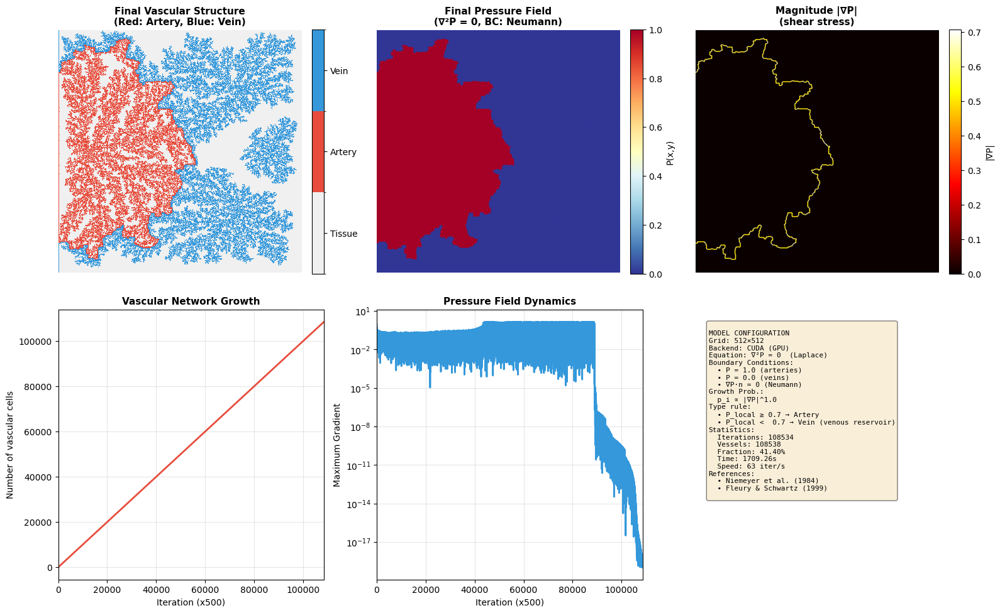

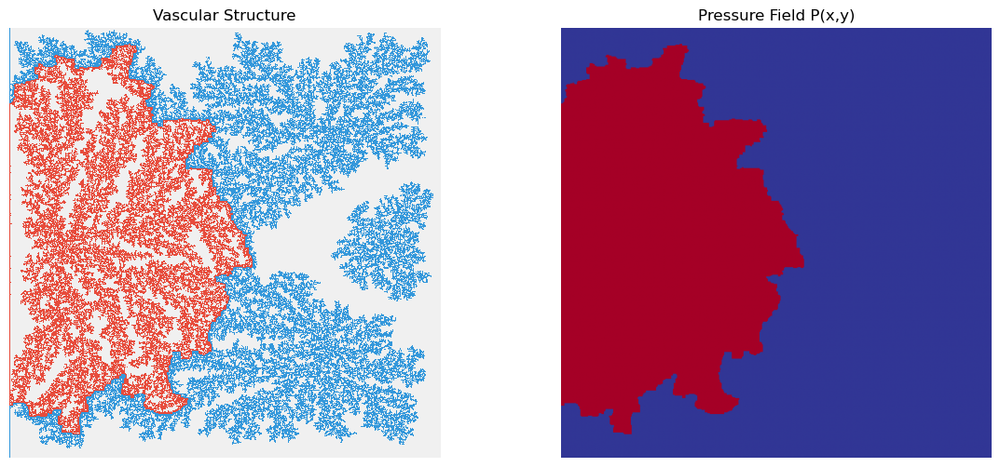


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_venous_reservoir_cuda.gif


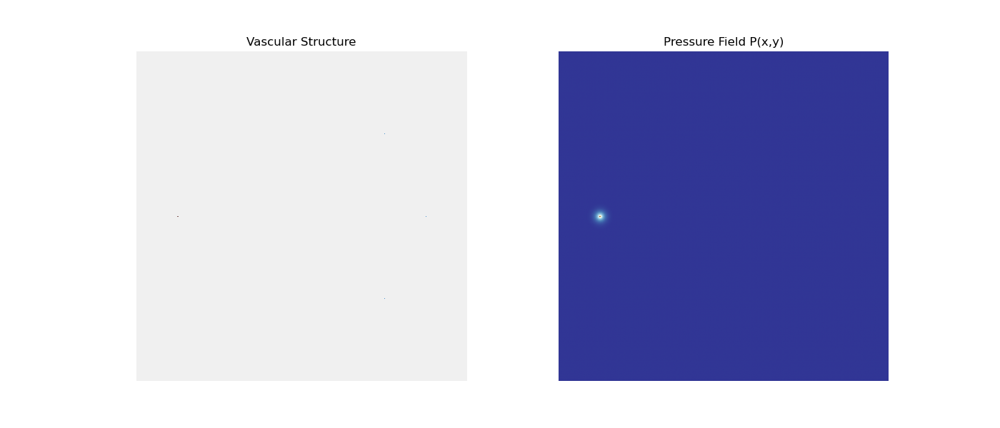

In [45]:
import os
from IPython.display import Image, display

# Asegurar carpeta de salida
os.makedirs("data", exist_ok=True)

def initialize_grid_gpu(size):
    """Initializes grid on GPU with venous-dominated seeding (1 artery, 3 veins)."""
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)
    
    # Coordenadas: (fila = eje x, columna = eje y)
    # 1 arteria principal a la izquierda; 3 venas repartidas hacia la derecha.
    points = [
        # Arteria principal (fuente de alta presión)
        (size // 2, size // 8, ARTERY),           # centro vertical, lado izquierdo

        # Venas (sumideros / reservorio)
        (size // 2, 7 * size // 8, VEIN),         # vena principal derecha
        (size // 4, 3 * size // 4, VEIN),         # vena superior-derecha
        (3 * size // 4, 3 * size // 4, VEIN),     # vena inferior-derecha
    ]
    
    for x, y, vtype in points:
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0
    
    return grid, pressure


"""
VASCULAR MORPHOGENESIS - Dielectric Breakdown Model (DBM) - CUDA OPTIMIZED
Venous reservoir configuration: 1 artery, 3 veins, pressure-based type decision
"""

# ==========================================
# CABECERA
# ==========================================
print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM (VENOUS RESERVOIR, CUDA)         ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# ==========================================
# MAIN SIMULATION
# ==========================================
print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")
history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []
start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid != TISSUE))
            if elapsed > 0:
                speed = iteration / elapsed
                print(
                    f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                    f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s",
                    end='\r'
                )
        
        # Resolver Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)
        
        # Crecimiento (usa growth_step_gpu redefinida arriba)
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)
        
        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break
        
        vessels_count.append(int(cp.sum(grid != TISSUE)))
        gradients_list.append(max_grad)
        
        # Guardar frames
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))
        
        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transferencia a CPU
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum(grid_np != TISSUE)}")
print(f"  Vascular fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%")

# ==========================================
# VISUALIZATION (CPU)
# ==========================================
print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']  # tissue, artery, vein
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Panel 1: Estructura vascular
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(history_grid[-1], cmap=cmap_vascular, norm=norm_vascular,
                 interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)',
              fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue', 'Artery', 'Vein'])

# Panel 2: Campo de presión
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1,
                 interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)',
              fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: Gradiente de presión
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: Evolución de vasos
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: Evolución del gradiente máximo
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: Información
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')
info_text = f"""
MODEL CONFIGURATION
Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}
Equation: ∇²P = 0  (Laplace)
Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)
Growth Prob.:
  p_i ∝ |∇P|^{ETA}
Type rule:
  • P_local ≥ 0.7 → Artery
  • P_local <  0.7 → Vein (venous reservoir)
Statistics:
  Iterations: {iteration}
  Vessels: {np.sum(grid_np != TISSUE)}
  Fraction: {100*np.sum(grid_np != TISSUE)/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s
References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""
ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_venous_reservoir_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")

# ==========================================
# ANIMATION
# ==========================================
print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

im_grid = ax_grid.imshow(
    history_grid[0],
    cmap=cmap_vascular,
    norm=norm_vascular,
    interpolation='nearest'
)
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(
    history_pressure[0],
    cmap='RdYlBu_r',
    vmin=0,
    vmax=1,
    interpolation='bilinear'
)
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    im_grid.set_data(history_grid[frame])
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(
    fig_anim,
    update_animation,
    frames=len(history_grid),
    interval=50,
    blit=True,
    repeat=True
)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")

    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ Animation save failed: {e}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)
print(f"I saved the animation as {animation_name}.gif")

display(Image(filename=f'{animation_name}.gif'))

#### The same at the paper (DOI: [10.1142/S0218348X99000050](https://doi.org/10.1142/S0218348X99000050))


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM with Internal Obstacles (CUDA)   ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 97500/500000 | Vessels: 97502 | Speed: 34 iter/s | Time: 2878.5s
✓ Simulation completed (saturation) at iteration 97816

✓ Simulation completed: 97816 iterations in 2884.96s
  Average speed: 34 iter/s
  Total vessels: 97818
  Vascular fraction: 37.31%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_obstacles_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_obstacles_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_obstacles_cuda.gif


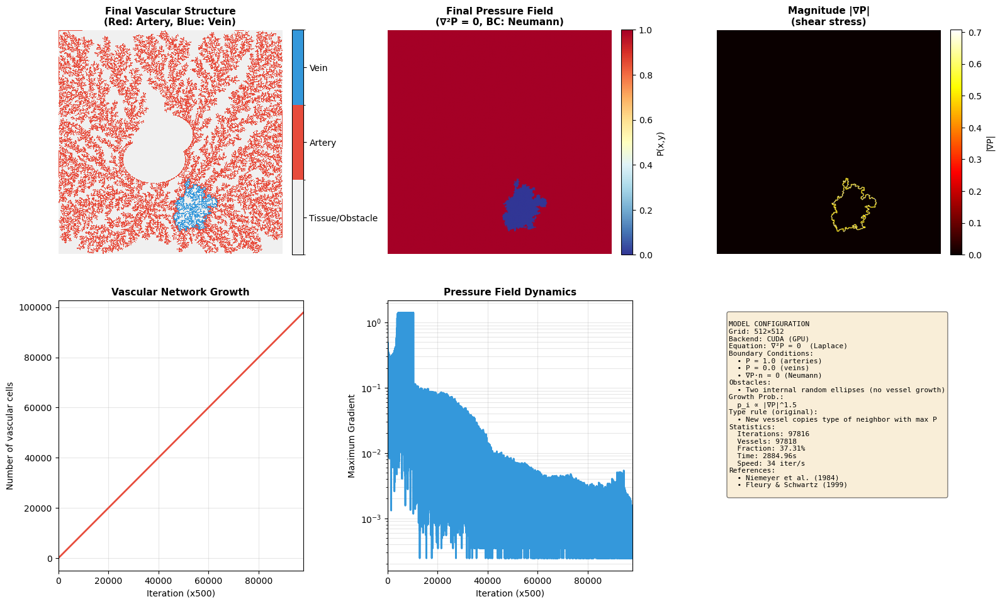

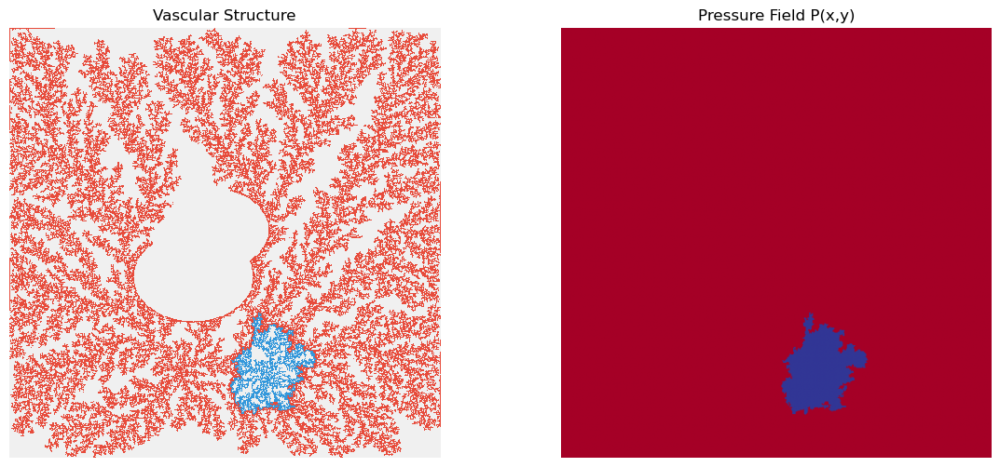


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_obstacles_cuda.gif


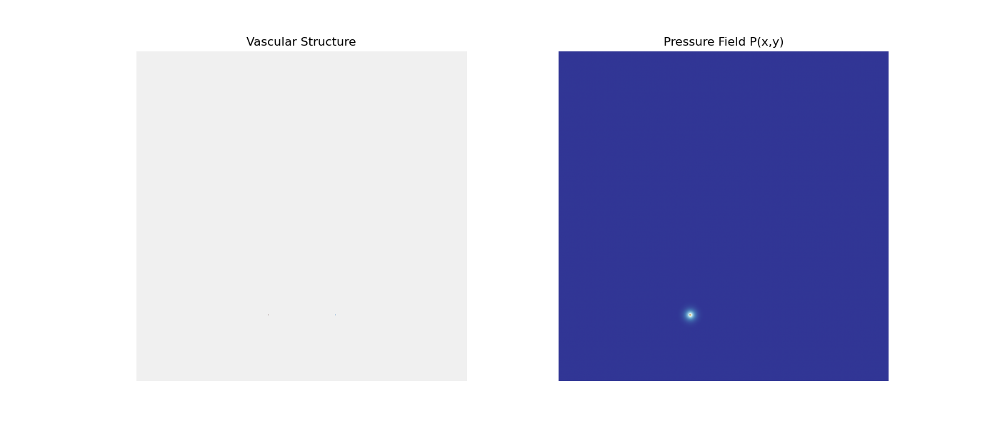

In [ ]:

import os
from IPython.display import Image, display

os.makedirs("data", exist_ok=True)

# ============================================================
# 1) INITIALIZE GRID WITH TWO INTERNAL OBSTACLES (NO GROWTH)
# ============================================================
def initialize_grid_gpu(size):
    """
    Inicializa la malla:
    - Dominio cuadrado.
    - Dos obstáculos internos (elipses aleatorias) donde no crecen vasos.
    - Una arteria y una vena en la parte inferior, separadas horizontalmente.
    """
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)

    # --- Obstáculos definidos en CPU para facilidad geométrica ---
    import numpy as np
    Y, X = np.ogrid[:size, :size]

    obstacles_np = np.zeros((size, size), dtype=bool)
    rng = np.random.default_rng()

    # Objeto auxiliar: elipse aleatoria en la región central
    def random_ellipse():
        cx = rng.integers(int(0.35*size), int(0.65*size))
        cy = rng.integers(int(0.35*size), int(0.65*size))
        rx = rng.integers(int(0.10*size), int(0.18*size))
        ry = rng.integers(int(0.08*size), int(0.16*size))
        mask = ((X - cy)/rx)**2 + ((Y - cx)/ry)**2 <= 1.0
        return mask

    # Dos elipses internas como obstáculos
    mask1 = random_ellipse()
    mask2 = random_ellipse()
    obstacles_np |= mask1 | mask2

    # Pasar obstáculos a GPU
    obstacles = cp.asarray(obstacles_np)
    grid[obstacles] = OBSTACLE

    # --- Semillas arteria / vena en la parte inferior del dominio ---
    # Nos aseguramos de ponerlas fuera de los obstáculos
    def place_seed(row_frac, col_frac, vtype):
        x = int(row_frac * size)
        y = int(col_frac * size)
        # Si cae dentro de un obstáculo, la desplazamos una fila hacia abajo
        while obstacles_np[x, y]:
            x = min(x + 1, size - 1)
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0

    # Arteria algo a la izquierda, vena algo a la derecha, ambas abajo
    place_seed(0.80, 0.40, ARTERY)
    place_seed(0.80, 0.60, VEIN)

    return grid, pressure


# ============================================================
# 2) SOLVER DE LAPLACE CON NEUMANN EN BORDES (SIN THRESHOLD)
# ============================================================
def solve_laplace_neumann_gpu(pressure, grid,
                              iterations=RELAXATION_STEPS,
                              tol=RELAXATION_TOL):
    """
    Resuelve ∇²P = 0 con:
    - P = 1.0 en arterias
    - P = 0.0 en venas
    - ∇P·n = 0 (Neumann) en el borde externo
    Obstáculos se tratan como tejido: no fijan P, solo bloquean el crecimiento.
    """
    P = pressure.copy()

    # Solo arterias y venas son Dirichlet
    is_vessel = (grid == ARTERY) | (grid == VEIN)

    for iteration in range(iterations):
        P_old = P.copy()

        # Laplaciano (5 puntos) en el interior
        P[1:-1, 1:-1] = 0.25 * (
            P[0:-2, 1:-1] + P[2:, 1:-1] +
            P[1:-1, 0:-2] + P[1:-1, 2:]
        )

        # Condiciones Neumann en bordes (reflexión)
        P[0, :]  = P[1, :]
        P[-1, :] = P[-2, :]
        P[:, 0]  = P[:, 1]
        P[:, -1] = P[:, -2]

        # Mantener Dirichlet en vasos (arteria/vena)
        P[is_vessel] = pressure[is_vessel]

        # Criterio de convergencia
        error = cp.max(cp.abs(P - P_old))
        if error < tol and iteration > 10:
            break

    return P


# ============================================================
# 3) CRECIMIENTO DBM ORIGINAL (SIN THRESHOLD), IGNORANDO OBSTÁCULOS
# ============================================================
def growth_step_gpu(grid, pressure):
    """
    Paso de crecimiento DBM (versión original sin threshold):
    - Candidatos: tejido que tiene al menos un vecino vascular (arteria o vena).
    - Probabilidad espacial ∝ |∇P|^ETA (compute_growth_probabilities_gpu).
    - Tipo de vaso nuevo: copia del vecino con mayor presión (P_arteria=1 > P_vena=0).
    - Obstáculos nunca se colonizan ni se consideran vasos.
    """
    tissue_mask = (grid == TISSUE)                           # solo tejido libre
    vessel_mask = (grid == ARTERY) | (grid == VEIN)          # solo vasos reales

    # Convolución para hallar celdas con al menos un vecino vascular (4-conectividad)
    kernel = cp.array([[0, 1, 0],
                       [1, 0, 1],
                       [0, 1, 0]], dtype=cp.float32)
    from cupyx.scipy import ndimage
    has_vessel_neighbor = ndimage.convolve(
        vessel_mask.astype(cp.float32),
        kernel,
        mode='constant'
    ) > 0

    candidates = tissue_mask & has_vessel_neighbor

    if not cp.any(candidates):
        return False, 0.0, 0

    # Campo de "gradientes" y probabilidades de crecimiento
    grads, probs = compute_growth_probabilities_gpu(pressure, grid)

    candidate_indices = cp.where(candidates)
    candidate_probs = probs[candidate_indices]

    if cp.sum(candidate_probs) == 0:
        return False, 0.0, 0

    candidate_probs = candidate_probs / cp.sum(candidate_probs)

    # Selección Monte Carlo
    flat_indices = cp.ravel_multi_index(candidate_indices, grid.shape)
    probabilities_array = cp.asnumpy(candidate_probs)
    winner_idx_in_candidates = np.random.choice(
        probabilities_array.size,
        p=probabilities_array
    )

    winner_flat_index = flat_indices[winner_idx_in_candidates]
    winner_pos = cp.unravel_index(winner_flat_index, grid.shape)
    x, y = int(winner_pos[0]), int(winner_pos[1])

    # Determinar tipo de vaso por vecino de mayor presión (ignorando obstáculos y tejido)
    max_pressure_neighbor = -1.0
    new_vessel_type = ARTERY  # valor por defecto

    for dx, dy in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
        nx = (x + dx) % grid.shape[0]
        ny = (y + dy) % grid.shape[1]
        if (grid[nx, ny] == ARTERY) or (grid[nx, ny] == VEIN):
            p_n = float(pressure[nx, ny])
            if p_n > max_pressure_neighbor:
                max_pressure_neighbor = p_n
                new_vessel_type = int(grid[nx, ny])

    # Expandir vaso y fijar presión
    grid[x, y] = new_vessel_type
    pressure[x, y] = 1.0 if new_vessel_type == ARTERY else 0.0

    max_grad = float(grads[x, y])
    return True, max_grad, new_vessel_type


# ============================================================
# 4) SIMULACIÓN COMPLETA + VISUALIZACIÓN + ANIMACIÓN
# ============================================================
print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM with Internal Obstacles (CUDA)   ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# MAIN SIMULATION
print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")
history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []
start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum(grid == ARTERY) + cp.sum(grid == VEIN))
            if elapsed > 0:
                speed = iteration / elapsed
                print(
                    f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                    f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s",
                    end='\r'
                )

        # Resolver Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)

        # Crecimiento
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)

        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break

        vessels_count.append(int(cp.sum((grid == ARTERY) | (grid == VEIN))))
        gradients_list.append(max_grad)

        # Guardar estados para animación
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))

        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transferir a CPU
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum((grid_np == ARTERY) | (grid_np == VEIN))}")
print(f"  Vascular fraction: {100*np.sum((grid_np == ARTERY) | (grid_np == VEIN))/grid_np.size:.2f}%")

# ============================================================
# VISUALIZACIÓN ESTÁTICA
# ============================================================
print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']  # tissue, artery, vein
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Para visualizar: mapear obstáculos (-1) a tejido (0) para ver los "agujeros"
grid_vis_final = history_grid[-1].copy()
grid_vis_final[grid_vis_final < 0] = 0

# Panel 1: estructura vascular
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(grid_vis_final, cmap=cmap_vascular, norm=norm_vascular,
                 interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)',
              fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue/Obstacle', 'Artery', 'Vein'])

# Panel 2: campo de presión
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1,
                 interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)',
              fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: |∇P|
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: crecimiento de vasos
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: dinámica del gradiente máximo
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: info
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')
info_text = f"""
MODEL CONFIGURATION
Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}
Equation: ∇²P = 0  (Laplace)
Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)
Obstacles:
  • Two internal random ellipses (no vessel growth)
Growth Prob.:
  p_i ∝ |∇P|^{ETA}
Type rule (original):
  • New vessel copies type of neighbor with max P
Statistics:
  Iterations: {iteration}
  Vessels: {np.sum((grid_np == ARTERY) | (grid_np == VEIN))}
  Fraction: {100*np.sum((grid_np == ARTERY) | (grid_np == VEIN))/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s
References:
  • Niemeyer et al. (1984)
  • Fleury & Schwartz (1999)
"""
ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_obstacles_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")

# ============================================================
# ANIMACIÓN
# ============================================================
print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

# Para animación también mapeamos obstáculos a tejido (0)
grid_vis0 = history_grid[0].copy()
grid_vis0[grid_vis0 < 0] = 0

im_grid = ax_grid.imshow(
    grid_vis0,
    cmap=cmap_vascular,
    norm=norm_vascular,
    interpolation='nearest'
)
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(
    history_pressure[0],
    cmap='RdYlBu_r',
    vmin=0,
    vmax=1,
    interpolation='bilinear'
)
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    grid_frame = history_grid[frame].copy()
    grid_frame[grid_frame < 0] = 0
    im_grid.set_data(grid_frame)
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(
    fig_anim,
    update_animation,
    frames=len(history_grid),
    interval=50,
    blit=True,
    repeat=True
)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")

    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ Animation save failed: {e}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)
print(f"I saved the animation as {animation_name}.gif")

display(Image(filename=f'{animation_name}.gif'))


╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM with Two Gaps (CUDA)             ║
║  Backend: CUDA (GPU)                              ║
║  Grid: 512x512 | Max iterations: 500000        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝


[1/3] Initializing grid on CUDA (GPU)...
[2/3] Running simulation...
  Step 110000/500000 | Vessels: 110002 | Speed: 24 iter/s | Time: 4567.6s
✓ Simulation completed (saturation) at iteration 110027

✓ Simulation completed: 110027 iterations in 4567.96s
  Average speed: 24 iter/s
  Total vessels: 110029
  Vascular fraction: 41.97%

[3/3] Generating visualization...
✓ Image saved: data/vascular_morphogenesis_obstacles_gap_cuda.pdf
Generating animation...
✓ Animation saved: data/vascular_morphogenesis_obstacles_gap_cuda.mp4
✓ GIF saved: data/vascular_morphogenesis_obstacles_gap_cuda.gif


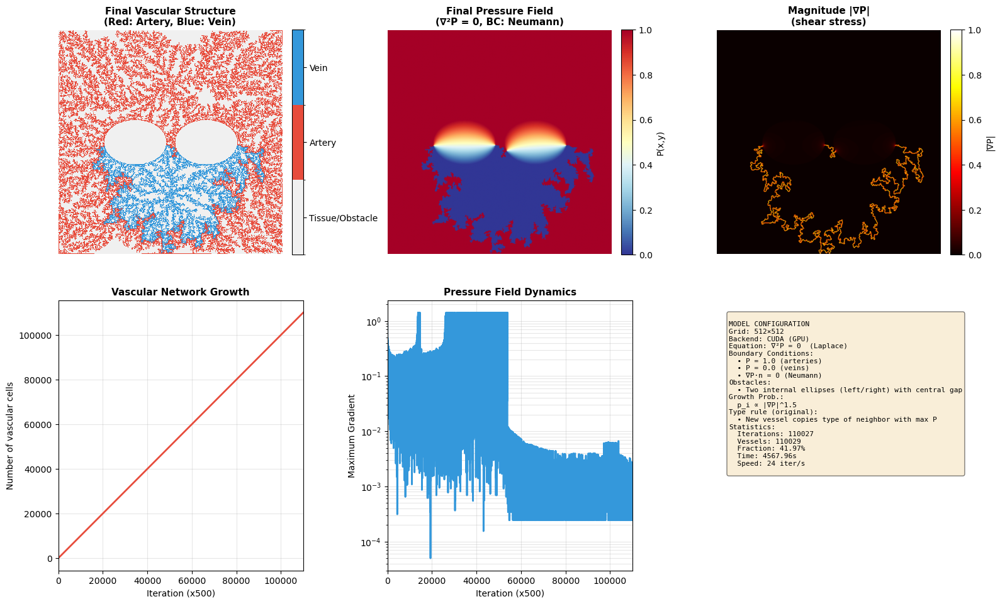

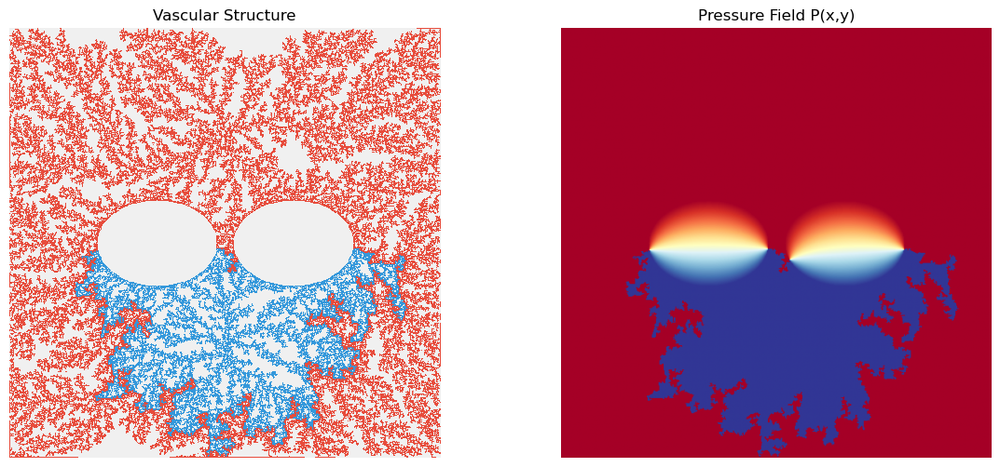


✓ CUDA SIMULATION COMPLETED
I saved the animation as data/vascular_morphogenesis_obstacles_gap_cuda.gif


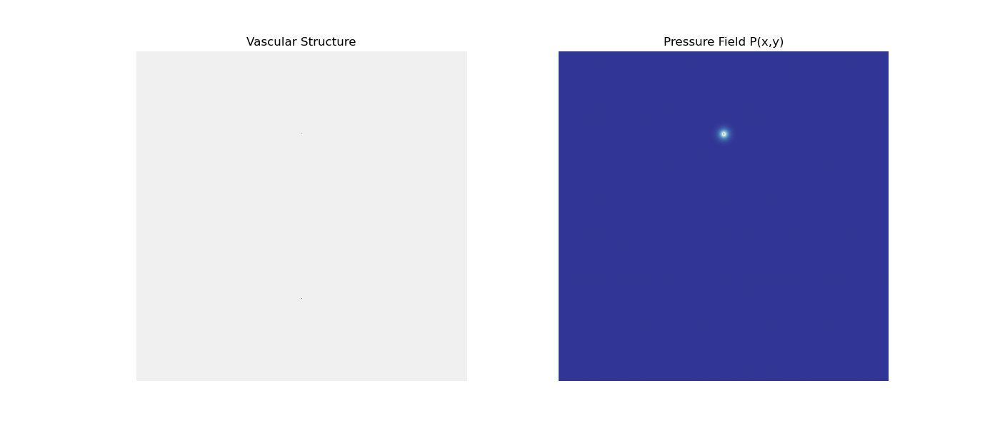

In [50]:
import os
from IPython.display import Image, display

os.makedirs("data", exist_ok=True)

# ============================================================
# 1) INITIALIZE GRID: DOS ELIPSES CON HUECO CENTRAL + ARTERIA ARRIBA / VENA ABAJO
# ============================================================
def initialize_grid_gpu(size):
    """
    Inicializa la malla:
    - Dominio cuadrado.
    - Dos elipses internas (obstáculos) izquierda/derecha, con un hueco central.
    - Una arteria arriba y una vena abajo, alineadas verticalmente.
    """
    grid = cp.zeros((size, size), dtype=cp.int32)
    pressure = cp.zeros((size, size), dtype=cp.float32)

    import numpy as np
    Y, X = np.ogrid[:size, :size]

    obstacles_np = np.zeros((size, size), dtype=bool)

    # Centro global
    cx = size // 2   # fila
    cy = size // 2   # columna

    # Parámetros de las elipses (horizontales) y separación
    rx = int(0.14 * size)   # semieje horizontal
    ry = int(0.10 * size)   # semieje vertical
    d  = int(0.16 * size)   # desplazamiento horizontal de los centros

    # Centros de las dos elipses (misma fila, columnas separadas)
    cx1, cy1 = cx, cy - d   # izquierda
    cx2, cy2 = cx, cy + d   # derecha

    # Máscaras elípticas
    mask1 = ((X - cy1) / rx)**2 + ((Y - cx1) / ry)**2 <= 1.0
    mask2 = ((X - cy2) / rx)**2 + ((Y - cx2) / ry)**2 <= 1.0

    obstacles_np |= mask1 | mask2

    # Pasar obstáculos a GPU
    obstacles = cp.asarray(obstacles_np)
    grid[obstacles] = OBSTACLE

    # --- Semillas: arteria arriba (sobre las elipses), vena abajo (debajo) ---
    def place_seed(row_frac, col_frac, vtype):
        x = int(row_frac * size)
        y = int(col_frac * size)
        # Si cae dentro de un obstáculo, desplazamos ligeramente hacia abajo
        while 0 <= x < size and obstacles_np[x, y]:
            x = min(x + 1, size - 1)
        grid[x, y] = vtype
        pressure[x, y] = 1.0 if vtype == ARTERY else 0.0

    # Arteria arriba, vena abajo, ambas centradas en columna media
    place_seed(0.25, 0.50, ARTERY)  # arteria superior
    place_seed(0.75, 0.50, VEIN)    # vena inferior

    return grid, pressure


# ============================================================
# 2) SOLVER DE LAPLACE CON NEUMANN EN BORDES
# ============================================================
def solve_laplace_neumann_gpu(pressure, grid,
                              iterations=RELAXATION_STEPS,
                              tol=RELAXATION_TOL):
    """
    Resuelve ∇²P = 0 con:
    - P = 1.0 en arterias
    - P = 0.0 en venas
    - ∇P·n = 0 (Neumann) en el borde externo
    Obstáculos se tratan como tejido: no fijan P, solo bloquean el crecimiento.
    """
    P = pressure.copy()

    # Solo arterias y venas son Dirichlet
    is_vessel = (grid == ARTERY) | (grid == VEIN)

    for iteration in range(iterations):
        P_old = P.copy()

        # Laplaciano (5 puntos) en el interior
        P[1:-1, 1:-1] = 0.25 * (
            P[0:-2, 1:-1] + P[2:, 1:-1] +
            P[1:-1, 0:-2] + P[1:-1, 2:]
        )

        # Condiciones Neumann en bordes (reflexión)
        P[0, :]  = P[1, :]
        P[-1, :] = P[-2, :]
        P[:, 0]  = P[:, 1]
        P[:, -1] = P[:, -2]

        # Mantener Dirichlet en vasos (arteria/vena)
        P[is_vessel] = pressure[is_vessel]

        # Criterio de convergencia
        error = cp.max(cp.abs(P - P_old))
        if error < tol and iteration > 10:
            break

    return P


# ============================================================
# 3) CRECIMIENTO DBM ORIGINAL (SIN THRESHOLD), IGNORANDO OBSTÁCULOS
# ============================================================
def growth_step_gpu(grid, pressure):
    """
    Paso de crecimiento DBM (versión original sin threshold):
    - Candidatos: tejido que tiene al menos un vecino vascular (arteria o vena).
    - Probabilidad espacial ∝ |∇P|^ETA (compute_growth_probabilities_gpu).
    - Tipo de vaso nuevo: copia del vecino con mayor presión (P_arteria=1 > P_vena=0).
    - Obstáculos nunca se colonizan ni se consideran vasos.
    """
    tissue_mask = (grid == TISSUE)                           # solo tejido libre
    vessel_mask = (grid == ARTERY) | (grid == VEIN)          # solo vasos

    # Convolución para hallar celdas con al menos un vecino vascular (4-conectividad)
    kernel = cp.array([[0, 1, 0],
                       [1, 0, 1],
                       [0, 1, 0]], dtype=cp.float32)
    from cupyx.scipy import ndimage
    has_vessel_neighbor = ndimage.convolve(
        vessel_mask.astype(cp.float32),
        kernel,
        mode='constant'
    ) > 0

    candidates = tissue_mask & has_vessel_neighbor

    if not cp.any(candidates):
        return False, 0.0, 0

    # Campo de "gradientes" y probabilidades de crecimiento
    grads, probs = compute_growth_probabilities_gpu(pressure, grid)

    candidate_indices = cp.where(candidates)
    candidate_probs = probs[candidate_indices]

    if cp.sum(candidate_probs) == 0:
        return False, 0.0, 0

    candidate_probs = candidate_probs / cp.sum(candidate_probs)

    # Selección Monte Carlo
    flat_indices = cp.ravel_multi_index(candidate_indices, grid.shape)
    probabilities_array = cp.asnumpy(candidate_probs)
    winner_idx_in_candidates = np.random.choice(
        probabilities_array.size,
        p=probabilities_array
    )

    winner_flat_index = flat_indices[winner_idx_in_candidates]
    winner_pos = cp.unravel_index(winner_flat_index, grid.shape)
    x, y = int(winner_pos[0]), int(winner_pos[1])

    # Determinar tipo de vaso por vecino de mayor presión (ignorando obstáculos y tejido)
    max_pressure_neighbor = -1.0
    new_vessel_type = ARTERY  # valor por defecto

    for dx, dy in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
        nx = (x + dx) % grid.shape[0]
        ny = (y + dy) % grid.shape[1]
        if (grid[nx, ny] == ARTERY) or (grid[nx, ny] == VEIN):
            p_n = float(pressure[nx, ny])
            if p_n > max_pressure_neighbor:
                max_pressure_neighbor = p_n
                new_vessel_type = int(grid[nx, ny])

    # Expandir vaso y fijar presión
    grid[x, y] = new_vessel_type
    pressure[x, y] = 1.0 if new_vessel_type == ARTERY else 0.0

    max_grad = float(grads[x, y])
    return True, max_grad, new_vessel_type


# ============================================================
# 4) SIMULACIÓN COMPLETA + VISUALIZACIÓN + ANIMACIÓN
# ============================================================
print(f"""
╔════════════════════════════════════════════════════════════════╗
║  VASCULAR MORPHOGENESIS - DBM with Two Gaps (CUDA)             ║
║  Backend: {BACKEND:<40}║
║  Grid: {GRID_SIZE}x{GRID_SIZE} | Max iterations: {MAX_ITERATIONS}        ║
║  Boundary Conditions: NEUMANN (∇P·n=0 at boundaries)           ║
╚════════════════════════════════════════════════════════════════╝
""")

# MAIN SIMULATION
print(f"\n[1/3] Initializing grid on {BACKEND}...")
grid, pressure = initialize_grid_gpu(GRID_SIZE)

print(f"[2/3] Running simulation...")
history_grid = []
history_pressure = []
iteration = 0
vessels_count = []
gradients_list = []
start_time = time.time()

try:
    while iteration < MAX_ITERATIONS:
        if iteration % 500 == 0:
            elapsed = time.time() - start_time
            n_vessels = int(cp.sum((grid == ARTERY) | (grid == VEIN)))
            if elapsed > 0:
                speed = iteration / elapsed
                print(
                    f"  Step {iteration}/{MAX_ITERATIONS} | Vessels: {n_vessels} | "
                    f"Speed: {speed:.0f} iter/s | Time: {elapsed:.1f}s",
                    end='\r'
                )

        # Resolver Laplace
        pressure = solve_laplace_neumann_gpu(pressure, grid)

        # Crecimiento
        growth_active, max_grad, vessel_type = growth_step_gpu(grid, pressure)

        if not growth_active:
            print(f"\n✓ Simulation completed (saturation) at iteration {iteration}")
            break

        vessels_count.append(int(cp.sum((grid == ARTERY) | (grid == VEIN))))
        gradients_list.append(max_grad)

        # Guardar estados para animación
        if iteration % (MAX_ITERATIONS // FRAMES_TO_SAVE) == 0:
            history_grid.append(cp.asnumpy(grid.copy()))
            history_pressure.append(cp.asnumpy(pressure.copy()))

        iteration += 1

except KeyboardInterrupt:
    print("\n⚠ Simulation interrupted")

elapsed = time.time() - start_time

# Transferir a CPU
grid_np = cp.asnumpy(grid)
pressure_np = cp.asnumpy(pressure)

print(f"\n✓ Simulation completed: {iteration} iterations in {elapsed:.2f}s")
print(f"  Average speed: {iteration/elapsed:.0f} iter/s")
print(f"  Total vessels: {np.sum((grid_np == ARTERY) | (grid_np == VEIN))}")
print(f"  Vascular fraction: {100*np.sum((grid_np == ARTERY) | (grid_np == VEIN))/grid_np.size:.2f}%")

# ============================================================
# VISUALIZACIÓN ESTÁTICA
# ============================================================
print("\n[3/3] Generating visualization...")

fig = plt.figure(figsize=(16, 10))

colors_vascular = ['#f0f0f0', '#e74c3c', '#3498db']  # tissue, artery, vein
cmap_vascular = ListedColormap(colors_vascular)
norm_vascular = BoundaryNorm([-0.5, 0.5, 1.5, 2.5], cmap_vascular.N)

# Para visualizar: mapear obstáculos (-1) a tejido (0)
grid_vis_final = history_grid[-1].copy()
grid_vis_final[grid_vis_final < 0] = 0

# Panel 1: estructura vascular
ax1 = plt.subplot(2, 3, 1)
im1 = ax1.imshow(grid_vis_final, cmap=cmap_vascular, norm=norm_vascular,
                 interpolation='nearest')
ax1.set_title('Final Vascular Structure\n(Red: Artery, Blue: Vein)',
              fontsize=11, fontweight='bold')
ax1.axis('off')
cbar1 = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04)
cbar1.set_ticks([0, 1, 2])
cbar1.set_ticklabels(['Tissue/Obstacle', 'Artery', 'Vein'])

# Panel 2: campo de presión
ax2 = plt.subplot(2, 3, 2)
pressure_final = history_pressure[-1]
im2 = ax2.imshow(pressure_final, cmap='RdYlBu_r', vmin=0, vmax=1,
                 interpolation='bilinear')
ax2.set_title('Final Pressure Field\n(∇²P = 0, BC: Neumann)',
              fontsize=11, fontweight='bold')
ax2.axis('off')
cbar2 = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04)
cbar2.set_label('P(x,y)')

# Panel 3: |∇P|
ax3 = plt.subplot(2, 3, 3)
Px = np.gradient(pressure_final, axis=0)
Py = np.gradient(pressure_final, axis=1)
grad_mag = np.sqrt(Px**2 + Py**2)
im3 = ax3.imshow(grad_mag, cmap='hot', interpolation='bilinear')
ax3.set_title('Magnitude |∇P|\n(shear stress)', fontsize=11, fontweight='bold')
ax3.axis('off')
cbar3 = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04)
cbar3.set_label('|∇P|')

# Panel 4: crecimiento de vasos
ax4 = plt.subplot(2, 3, 4)
ax4.plot(vessels_count, linewidth=2, color='#e74c3c')
ax4.set_xlabel('Iteration (x500)', fontsize=10)
ax4.set_ylabel('Number of vascular cells', fontsize=10)
ax4.set_title('Vascular Network Growth', fontsize=11, fontweight='bold')
ax4.grid(True, alpha=0.3)
ax4.set_xlim([0, len(vessels_count)])

# Panel 5: dinámica del gradiente máximo
ax5 = plt.subplot(2, 3, 5)
ax5.semilogy(gradients_list, linewidth=2, color='#3498db')
ax5.set_xlabel('Iteration (x500)', fontsize=10)
ax5.set_ylabel('Maximum Gradient', fontsize=10)
ax5.set_title('Pressure Field Dynamics', fontsize=11, fontweight='bold')
ax5.grid(True, alpha=0.3, which='both')
ax5.set_xlim([0, len(gradients_list)])

# Panel 6: info
ax6 = plt.subplot(2, 3, 6)
ax6.axis('off')
info_text = f"""
MODEL CONFIGURATION
Grid: {GRID_SIZE}×{GRID_SIZE}
Backend: {BACKEND}
Equation: ∇²P = 0  (Laplace)
Boundary Conditions:
  • P = 1.0 (arteries)
  • P = 0.0 (veins)
  • ∇P·n = 0 (Neumann)
Obstacles:
  • Two internal ellipses (left/right) with central gap
Growth Prob.:
  p_i ∝ |∇P|^{ETA}
Type rule (original):
  • New vessel copies type of neighbor with max P
Statistics:
  Iterations: {iteration}
  Vessels: {np.sum((grid_np == ARTERY) | (grid_np == VEIN))}
  Fraction: {100*np.sum((grid_np == ARTERY) | (grid_np == VEIN))/grid_np.size:.2f}%
  Time: {elapsed:.2f}s
  Speed: {iteration/elapsed:.0f} iter/s
"""
ax6.text(0.05, 0.95, info_text, transform=ax6.transAxes,
         fontsize=8, verticalalignment='top', family='monospace',
         bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

animation_name = 'data/vascular_morphogenesis_obstacles_gap_cuda'

plt.tight_layout()
plt.savefig(f'{animation_name}.pdf', bbox_inches='tight')
print(f"✓ Image saved: {animation_name}.pdf")

# ============================================================
# ANIMACIÓN
# ============================================================
print("Generating animation...")

fig_anim, (ax_grid, ax_pressure) = plt.subplots(1, 2, figsize=(14, 6))

grid_vis0 = history_grid[0].copy()
grid_vis0[grid_vis0 < 0] = 0

im_grid = ax_grid.imshow(
    grid_vis0,
    cmap=cmap_vascular,
    norm=norm_vascular,
    interpolation='nearest'
)
ax_grid.set_title('Vascular Structure')
ax_grid.axis('off')

im_pressure = ax_pressure.imshow(
    history_pressure[0],
    cmap='RdYlBu_r',
    vmin=0,
    vmax=1,
    interpolation='bilinear'
)
ax_pressure.set_title('Pressure Field P(x,y)')
ax_pressure.axis('off')

def update_animation(frame):
    grid_frame = history_grid[frame].copy()
    grid_frame[grid_frame < 0] = 0
    im_grid.set_data(grid_frame)
    im_pressure.set_data(history_pressure[frame])
    return [im_grid, im_pressure]

anim = animation.FuncAnimation(
    fig_anim,
    update_animation,
    frames=len(history_grid),
    interval=50,
    blit=True,
    repeat=True
)

try:
    anim.save(f'{animation_name}.mp4', writer='ffmpeg', fps=20, dpi=100)
    print(f"✓ Animation saved: {animation_name}.mp4")

    anim.save(f'{animation_name}.gif', writer='pillow', fps=10)
    print(f"✓ GIF saved: {animation_name}.gif")
except Exception as e:
    print(f"⚠ Animation save failed: {e}")

plt.show()

print("\n" + "="*60)
print("✓ CUDA SIMULATION COMPLETED")
print("="*60)
print(f"I saved the animation as {animation_name}.gif")

display(Image(filename=f'{animation_name}.gif'))